# Environment Setup

In [1]:
!pip install gpytoolbox

In [2]:
import gpytoolbox as gpy
import numpy as np
import matplotlib.pyplot as plt
import utils
import torch
from torch.utils.data import DataLoader


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device: {}".format(device))

Using device: cuda


# Dataset

In [3]:
from torchvision import transforms

def pcmnist(batch_size=16, size=128, num_samples=300, path_to_data='mnist_data/', augment=False, label=0):
    """PointCloudMNIST dataloader.

    Parameters
    ----------
    batch_size : int

    size : int
        Size (height and width) of each image. Default is 28 for no resizing.

    path_to_data : string
        Path to MNIST data files.
    """
    all_transforms = transforms.Compose([
        transforms.Resize(size),
    ])

    train_data = utils.PointCloudMNISTDataset(path_to_data, train=True, download=True,
                                transform=all_transforms, num_samples=num_samples,random_seed=2, augment=augment)

    train_idx = train_data.targets == label
    train_data.data = train_data.train_data[train_idx]
    train_data.targets = train_data.train_labels[train_idx]    

    test_data = utils.PointCloudMNISTDataset(path_to_data, train=False,
                               transform=all_transforms, num_samples=num_samples,random_seed=2, augment=False)
    
    test_idx = test_data.targets == label
    test_data.data = test_data.test_data[test_idx]
    test_data.targets = test_data.test_labels[test_idx]    

    train_loader = DataLoader(train_data, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_data, batch_size=batch_size, shuffle=True)

    return train_loader, test_loader

/opt/conda/lib/python3.10/site-packages/torchvision/datasets/mnist.py:75: UserWarning: train_data has been renamed data
  warnings.warn("train_data has been renamed data")
/opt/conda/lib/python3.10/site-packages/torchvision/datasets/mnist.py:65: UserWarning: train_labels has been renamed targets
  warnings.warn("train_labels has been renamed targets")
/opt/conda/lib/python3.10/site-packages/torchvision/datasets/mnist.py:80: UserWarning: test_data has been renamed data
  warnings.warn("test_data has been renamed data")
/opt/conda/lib/python3.10/site-packages/torchvision/datasets/mnist.py:70: UserWarning: test_labels has been renamed targets
  warnings.warn("test_labels has been renamed targets")
/host/home/jpvt/Documents/SGI/repos/sampling-surfaces/utils/data/pcmnist.py:104: RuntimeWarning: invalid value encountered in divide
  vecs /= np.linalg.norm(vecs, axis=1)[:,None]


torch.Size([500, 2]) torch.Size([500])


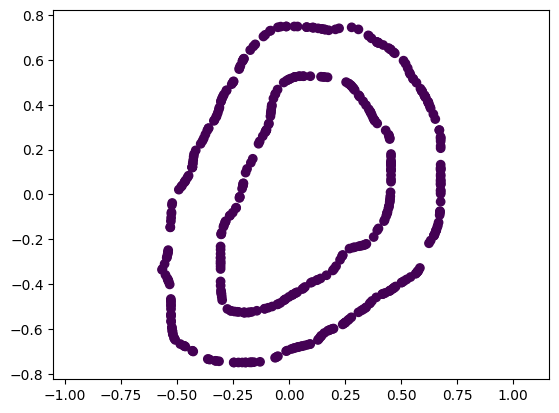

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
torch.Size([500, 2]) torch.Size([500])


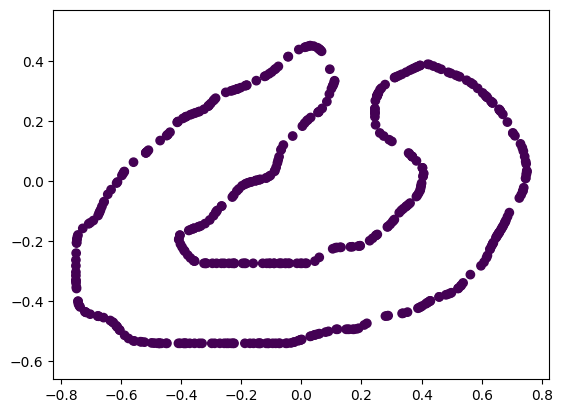

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
torch.Size([500, 2]) torch.Size([500])


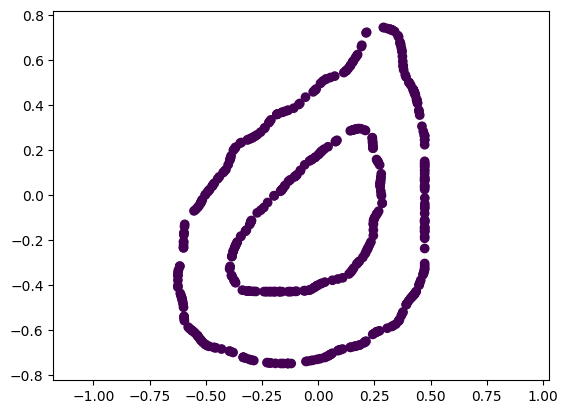

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])


In [4]:
BATCH_SIZE=64
IMG_SIZE=128
SAMPLE_SIZE = 500
train_dataloader, test_dataloader = pcmnist(batch_size=BATCH_SIZE, size=IMG_SIZE, num_samples=SAMPLE_SIZE)

i = 0
for Xs, Ys, normals, target in test_dataloader:
  X = Xs[0]
  Y = Ys[0]

  print(X.shape, Y.shape)
  plt.scatter(X[:,0],X[:,1], c=Y)
  plt.axis("equal")
  plt.show()
  print(target)
  i +=1
  
  if i == 3:
    break

## Utils

In [5]:
def plot_neural_process(xs, ys, mu, std, X,y, grid_size, plot_sample=1):
    """
    Plot Mean and Std of Neural Process side by side.

    Parameters:
    - xs: x grid values
    - ys: y grid values
    - mu: mean tensor values
    - std: standard deviation tensor values
    - X: scatter plot data
    """
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    X = X.cpu()
    y = y.cpu().numpy()
    print(X.shape)
    # Mean of Neural Process plot
    axes[0].set_title("Mean of Neural Process")
    c1 = axes[0].pcolormesh(xs, ys, mu.cpu().view((grid_size,grid_size)).detach().numpy(), shading='gouraud', cmap="viridis")
    fig.colorbar(c1, ax=axes[0])
    axes[0].contour(xs, ys, mu.cpu().view((grid_size,grid_size)).detach().numpy(), levels=[0], colors='black')
    axes[0].scatter(X[0][:,0].numpy(), X[0][:,1].numpy(), c=y, cmap="viridis")

    # Std of Neural Process plot
    axes[1].set_title("Std of Neural Process")
    c2 = axes[1].pcolormesh(xs, ys, std.cpu().view((grid_size,grid_size)).detach().numpy(), shading='gouraud', cmap="plasma")
    fig.colorbar(c2, ax=axes[1])
    axes[1].scatter(X[0][:,0].numpy(), X[0][:,1].numpy(), c=y, cmap="viridis")
    
    plt.tight_layout()
    plt.show()

    if plot_sample > 0:
        m = torch.distributions.normal.Normal(mu, std)
        for i in range(plot_sample):
            sample = m.rsample().detach()

            plt.title("Sample of Neural Process")
            plt.pcolormesh(xs,ys,sample.cpu().reshape((grid_size,grid_size)).detach().numpy(),shading='gouraud',cmap="plasma")
            plt.colorbar()
            plt.contour(xs,ys,sample.cpu().reshape((grid_size,grid_size)).detach().numpy(),levels=[0], colors='black')
            plt.scatter(X[0][:,0].numpy(), X[0][:,1].numpy(), c=y, cmap="viridis")
            plt.tight_layout()
            plt.show()

In [6]:
def get_context_and_target(x, normals, n_context, n_target):
    # Ensure n_context is less than or equal to n_target
    assert n_context <= n_target, "n_context should be less than or equal to n_target"

    batch_size = x.size(0)
    
    x_context_list, y_context_list, x_target_list, y_target_list = [], [], [], []
    
    for b in range(batch_size):
        # Sample n_target indices from the range [0, x.size(1)-1]
        target_indices = torch.randperm(x.size(1))[:n_target]

        # Get x_target and y_target values for the batch
        x_target_b = x[b, target_indices]
        normals_target_b = normals[b, target_indices]

        # From the n_target indices, subsample n_context indices
        context_indices = torch.randperm(n_target)[:n_context]

        # Get x_context and y_context values for the batch
        #print(context_indices.shape, context_indices)
        #print(x_target_b.shape, y_target_b.shape)
        x_context_b = x_target_b[context_indices]
        normals_context_b = normals_target_b[context_indices]

        x_context_b, y_context_b = utils.data.generate_pts_from_normals(x_context_b.cpu().numpy(), normals_context_b.cpu().numpy())
        x_context_b, y_context_b = torch.tensor(x_context_b, dtype=torch.float32), torch.tensor(y_context_b,dtype=torch.float32)

        x_target_b, y_target_b = utils.data.generate_pts_from_normals(x_target_b.cpu().numpy(), normals_target_b.cpu().numpy())
        x_target_b, y_target_b = torch.tensor(x_target_b, dtype=torch.float32), torch.tensor(y_target_b,dtype=torch.float32)
        
        x_context_list.append(x_context_b)
        y_context_list.append(y_context_b)
        x_target_list.append(x_target_b)
        y_target_list.append(y_target_b)
    
    x_context = torch.stack(x_context_list)
    y_context = torch.stack(y_context_list)
    x_target = torch.stack(x_target_list)
    y_target = torch.stack(y_target_list)

    return x_context, y_context, x_target, y_target

In [7]:
def test(model, dataloader, writer=None, plot=True, global_step=None, seed=42, title='', size=50, grid_size=100, use_normals=False):
    model.eval()
    model.to(device)
    with torch.no_grad():
        Xs, Ys, _, labels = next(iter(dataloader))
        context_x, context_y, label = Xs[0], Ys[0], labels[0]
        context_indices = torch.randperm(context_x.size(0))[:size]
        context_x = torch.Tensor(context_x[context_indices]).reshape((1,size,2)).to(device)
        context_y = torch.Tensor(context_y[context_indices]).reshape((1,size,1)).to(device)
        #print(context_x.shape, context_y.shape)
        
        # Create a set of target points corresponding to entire [-pi, pi] range
        xs = np.linspace(-1,1,grid_size)
        ys = np.linspace(-1,1,grid_size)
        Xs,Ys = np.meshgrid(xs,ys)
        Xs = Xs.flatten()
        Ys = Ys.flatten()
        grid = np.vstack((Xs,Ys)).T
        target_x = torch.Tensor(grid).reshape(1,grid_size**2,2).to(device)

        #print(context_x.shape, context_y.shape, target_x.shape)
        y_pred, kl, loss, mse_loss, y_std = model(context_x, context_y, target_x)

        if writer is not None:
            writer.add_scalar('val/loss', loss, global_step=global_step)
            writer.add_scalar('val/y_std', y_std.mean(), global_step=global_step)
            writer.add_scalar('val/mse_loss', mse_loss, global_step=global_step)
            writer.add_scalar('val/kl', kl.mean(), global_step=global_step)

        if plot:
            print("Original Label: ", label)
            plot_neural_process(xs,ys,y_pred,y_std, context_x, context_y, grid_size)
            if writer is not None:
                writer.add_figure('test', global_step=global_step, close=False)
            plt.show()

    return y_pred, kl, loss, y_std

In [8]:
def test_progress(model, dataloader, writer=None, plot=True, global_step=None, seed=42, title='', sizes=[50,100], grid_size=100, use_normals=False):
    model.eval()
    model.to(device)
    with torch.no_grad():
        X, Y, normals, labels = next(iter(dataloader))
        for size in sizes:
            context_x, context_y, normal, label = X[0], Y[0],normals[0], labels[0]
            context_indices = torch.randperm(context_x.size(0))[:size]

            context_x, context_y = utils.data.generate_pts_from_normals(context_x[context_indices].cpu().numpy(), normal[context_indices].cpu().numpy())
            context_x, context_y = torch.tensor(context_x, dtype=torch.float32), torch.tensor(context_y,dtype=torch.float32)
            context_x = context_x.reshape((1,size,2)).to(device)
            context_y = context_y.reshape((1,size,1)).to(device)
            #print(context_x.shape, context_y.shape)
            
            # Create a set of target points corresponding to entire [-pi, pi] range
            xs = np.linspace(-1,1,grid_size)
            ys = np.linspace(-1,1,grid_size)
            Xs,Ys = np.meshgrid(xs,ys)
            Xs = Xs.flatten()
            Ys = Ys.flatten()
            grid = np.vstack((Xs,Ys)).T
            target_x = torch.Tensor(grid).reshape(1,grid_size**2,2).to(device)

            #print(context_x.shape, context_y.shape, target_x.shape)
            y_pred, kl, loss, mse_loss, y_std = model(context_x, context_y, target_x)

            if writer is not None:
                writer.add_scalar('val/loss', loss, global_step=global_step)
                writer.add_scalar('val/y_std', y_std.mean(), global_step=global_step)
                writer.add_scalar('val/mse_loss', mse_loss, global_step=global_step)
                writer.add_scalar('val/kl', kl.mean(), global_step=global_step)

            if plot:
                print("Original Label: ", label)
                print("N context points: ", size)
                plot_neural_process(xs,ys,y_pred,y_std, context_x, context_y, grid_size)
                if writer is not None:
                    writer.add_figure('test', global_step=global_step, close=False)
                plt.show()

In [9]:
from tqdm import tqdm

def evaluate(model, n=100):
    return torch.stack([
        test(model)[2] for _ in tqdm(range(n))
    ]).mean().cpu()

# Attentive Neural Process

In [16]:
from src.model import LatentModel

hparams = dict(
    x_dim=2,
    y_dim=1,
    hidden_dim=256,
    latent_dim=256,
    n_latent_encoder_layers=4,
    n_det_encoder_layers=4,
    n_decoder_layers=4,
    attention_layers=3,
    latent_enc_self_attn_type="uniform",
    det_enc_self_attn_type="uniform",
    det_enc_cross_attn_type="multihead",
    use_rnn=False)

model = LatentModel(**hparams).to(device)
optim = torch.optim.Adam(model.parameters(), lr=1e-4)

n_context = 100
n_target = 400
epochs = 30
PRINT_AFTER = 500

## Training Model

In [17]:
def train(model, optim, train_dataloader, test_dataloader, epochs, n_context, n_target, plot=True):
    for epoch in range(epochs):
        epoch_loss = 0.
        with tqdm(train_dataloader, unit="batch") as tepoch:
            for data in tepoch:
                tepoch.set_description(f"Epoch {epoch}")
                model.train()

                x, y, normals, target = data
                x=x.to(device)
                normals = normals.to(device)
                #y=y.unsqueeze(-1).to(device)

                context_x, context_y, target_x, target_y = get_context_and_target(x, normals, n_context, n_target)
                #print(context_x.shape, context_y.shape, target_x.shape, target_y.shape)
                context_x = context_x.to(device)
                context_y = context_y.unsqueeze(-1).to(device)
                target_x = target_x.to(device)
                target_y = target_y.unsqueeze(-1).to(device)
                #print(context_x.shape, context_y.shape, target_x.shape, target_y.shape)
                optim.zero_grad()
                y_pred, kl, loss, mse_loss, y_std = model(context_x, context_y, target_x,target_y)
                epoch_loss += loss.item()
                loss.backward()
                optim.step()

                if (tepoch.n - 1) % PRINT_AFTER == 0:
                    _, _, _, _ = test(
                        model, test_dataloader, plot=plot, global_step=tepoch.n-1, size=n_context)
                    # print(
                    #     f"train: {tepoch.n - 1} loss={loss.item(): 4.4g} val_loss={val_loss.item(): 4.4g}"
                    # )
                tepoch.set_postfix(loss=loss.item())

        print("Epoch: {}, Avg_loss: {}".format(epoch, epoch_loss / len(train_dataloader)))
            

Epoch 0:   1%|▏                   | 1/93 [00:00<00:40,  2.29batch/s, loss=0.596]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


/tmp/ipykernel_549/2363007050.py:20: UserWarning: No contour levels were found within the data range.
  axes[0].contour(xs, ys, mu.cpu().view((grid_size,grid_size)).detach().numpy(), levels=[0], colors='black')


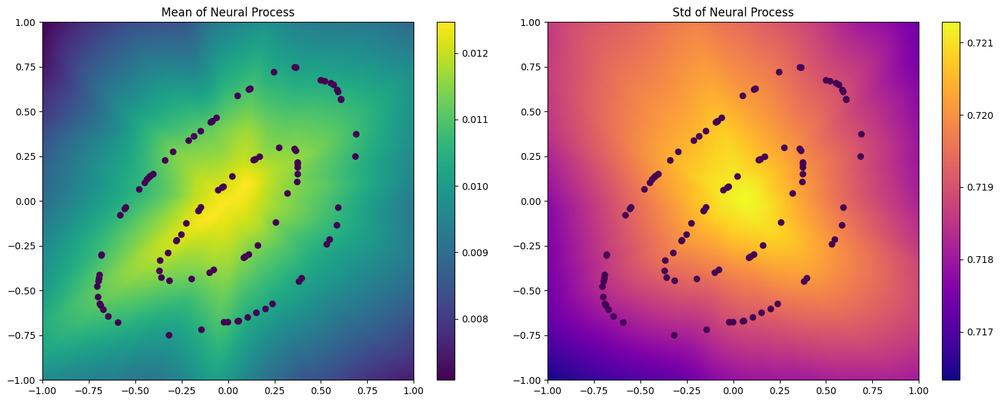

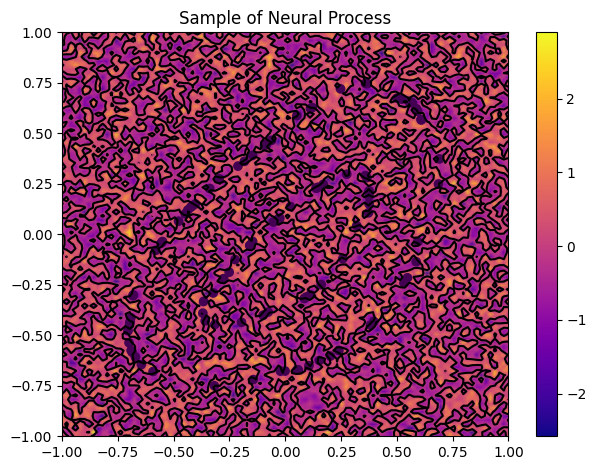

Epoch 0: 100%|███████████████████| 93/93 [00:37<00:00,  2.45batch/s, loss=-1.42]


Epoch: 0, Avg_loss: -0.6811277084753559


Epoch 1:   1%|▏                    | 1/93 [00:00<00:40,  2.26batch/s, loss=-1.4]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


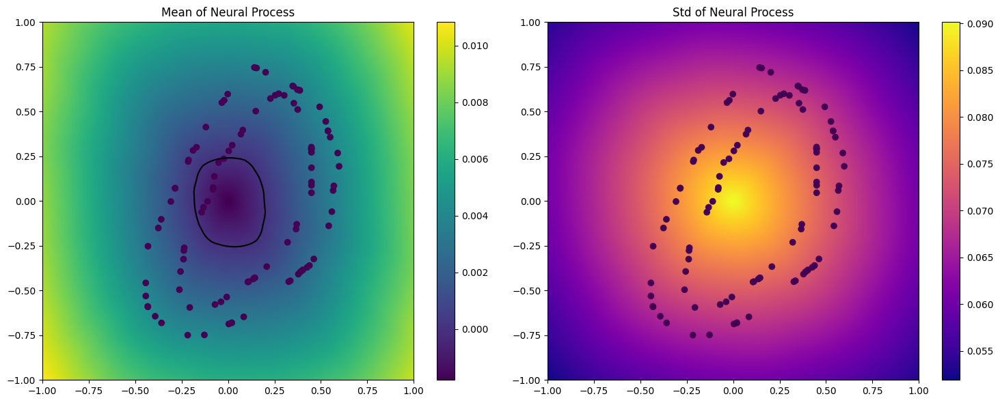

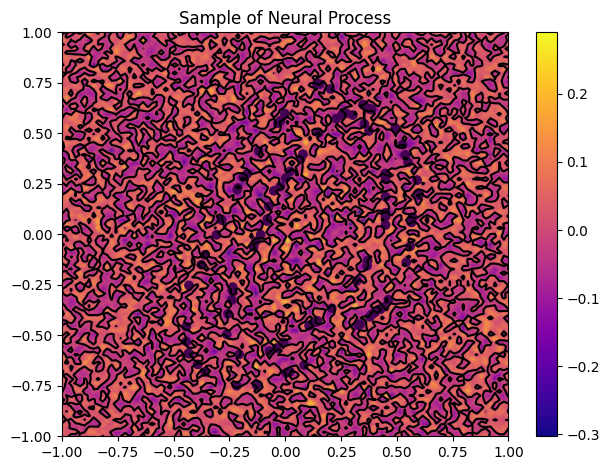

Epoch 1: 100%|███████████████████| 93/93 [00:37<00:00,  2.47batch/s, loss=-1.43]


Epoch: 1, Avg_loss: -1.416186499339278


Epoch 2:   1%|▏                   | 1/93 [00:00<00:36,  2.51batch/s, loss=-1.43]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


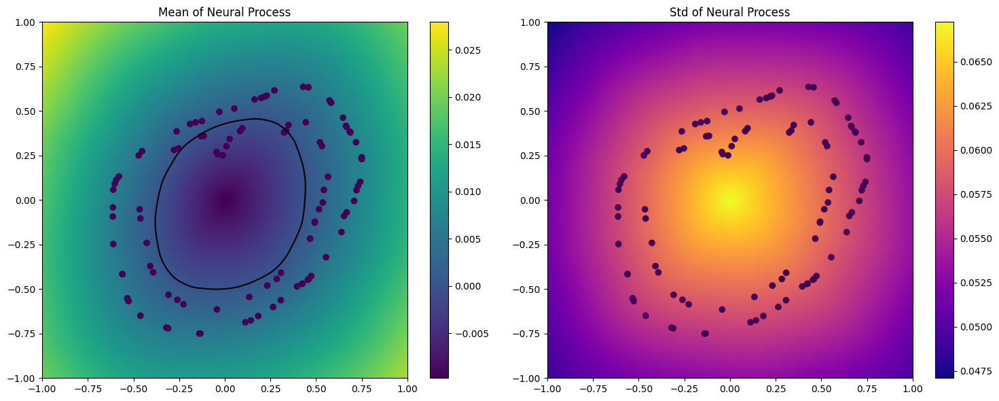

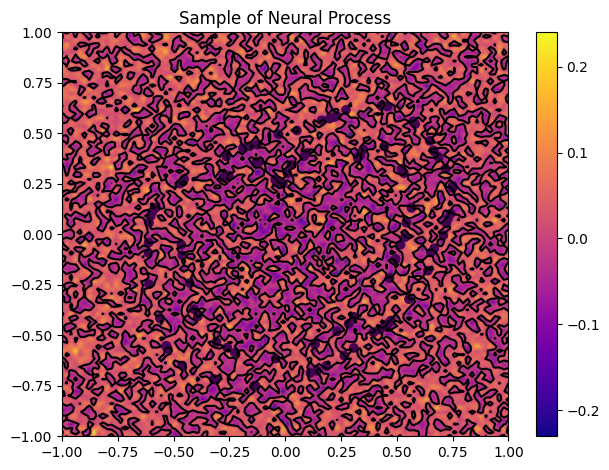

Epoch 2: 100%|███████████████████| 93/93 [00:36<00:00,  2.55batch/s, loss=-1.44]


Epoch: 2, Avg_loss: -1.4322597031952233


Epoch 3:   1%|▏                   | 1/93 [00:00<00:37,  2.43batch/s, loss=-1.44]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


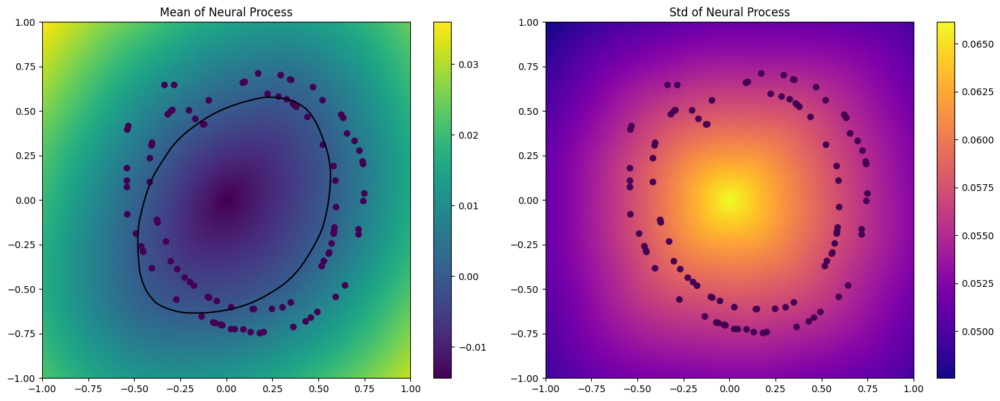

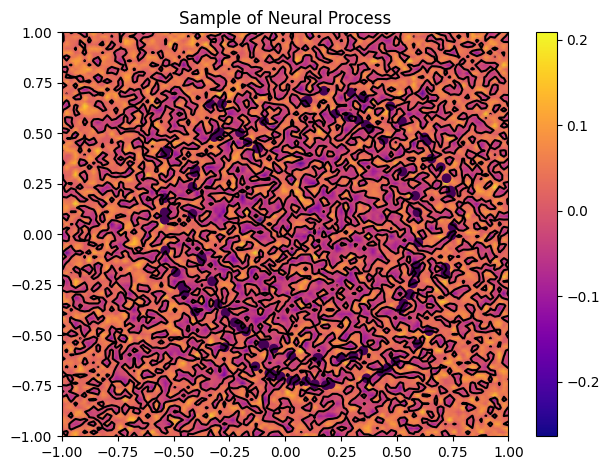

Epoch 3: 100%|███████████████████| 93/93 [00:38<00:00,  2.44batch/s, loss=-1.44]


Epoch: 3, Avg_loss: -1.4384858941519132


Epoch 4:   1%|▏                   | 1/93 [00:00<00:44,  2.07batch/s, loss=-1.44]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


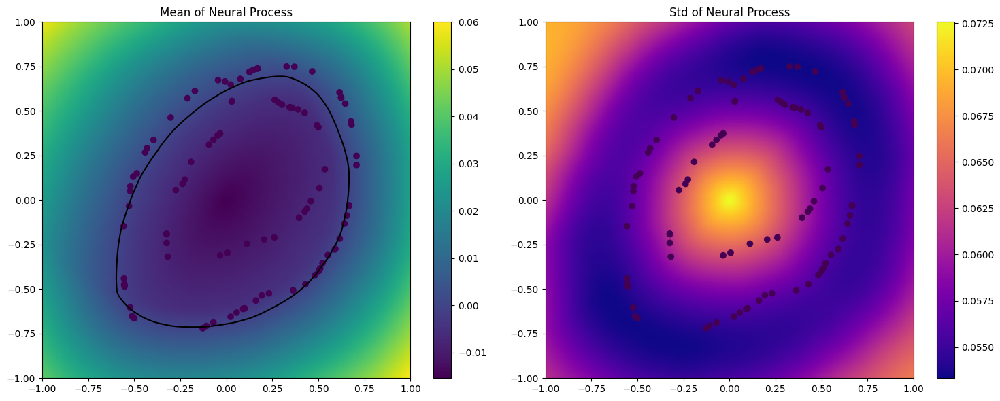

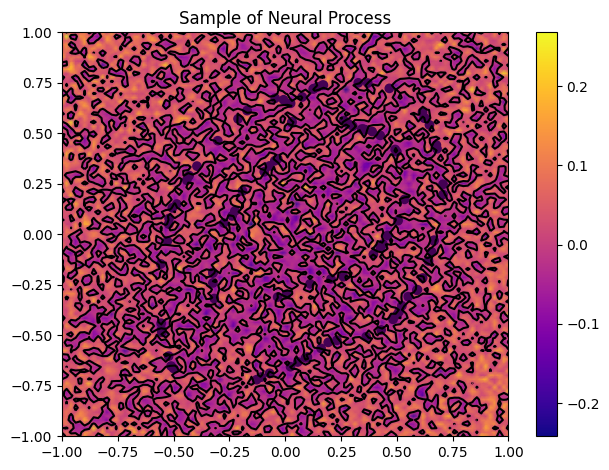

Epoch 4: 100%|███████████████████| 93/93 [00:38<00:00,  2.40batch/s, loss=-1.49]


Epoch: 4, Avg_loss: -1.4635354536835865


Epoch 5:   1%|▏                   | 1/93 [00:00<00:39,  2.35batch/s, loss=-1.49]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


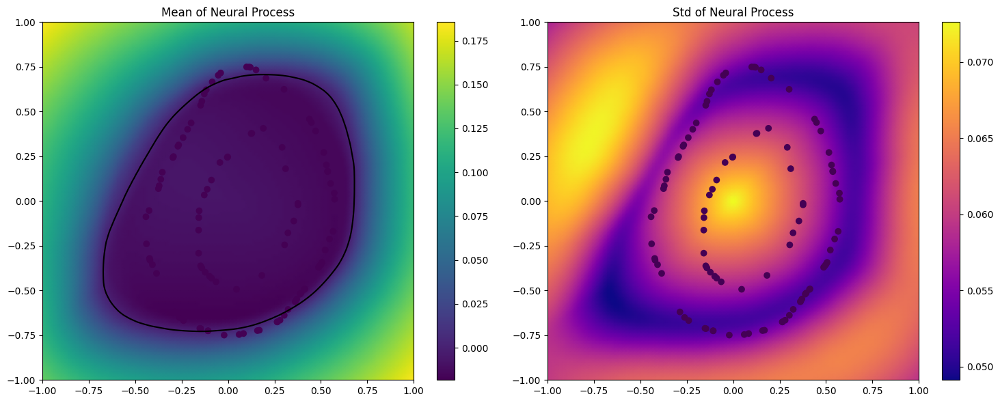

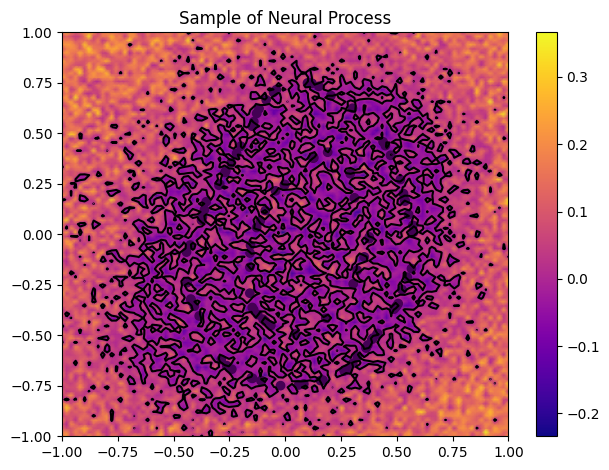

Epoch 5: 100%|███████████████████| 93/93 [00:36<00:00,  2.53batch/s, loss=-1.53]


Epoch: 5, Avg_loss: -1.5090889712815643


Epoch 6:   1%|▏                   | 1/93 [00:00<00:37,  2.48batch/s, loss=-1.54]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


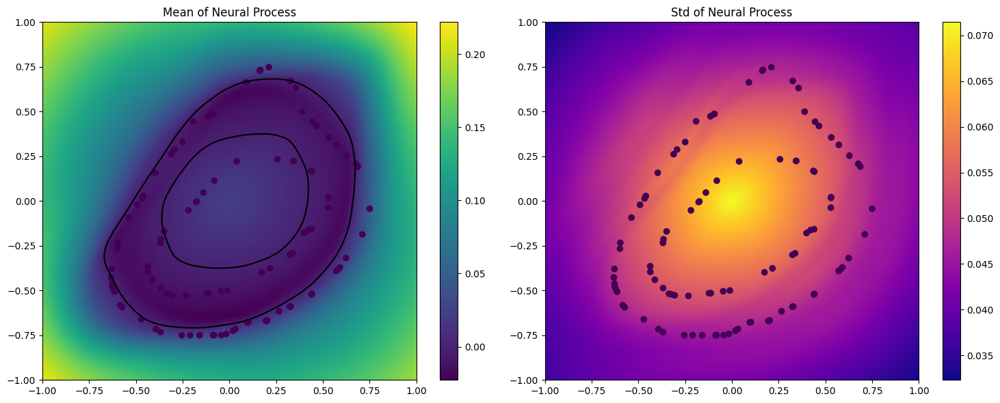

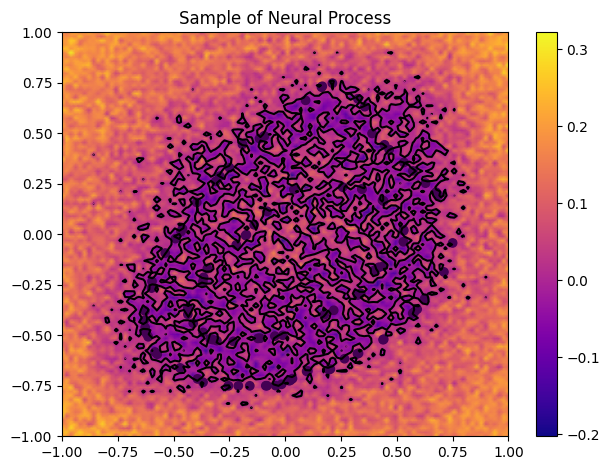

Epoch 6: 100%|███████████████████| 93/93 [00:36<00:00,  2.55batch/s, loss=-1.41]


Epoch: 6, Avg_loss: -1.5217124608255201


Epoch 7:   1%|▏                   | 1/93 [00:00<00:39,  2.34batch/s, loss=-1.54]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


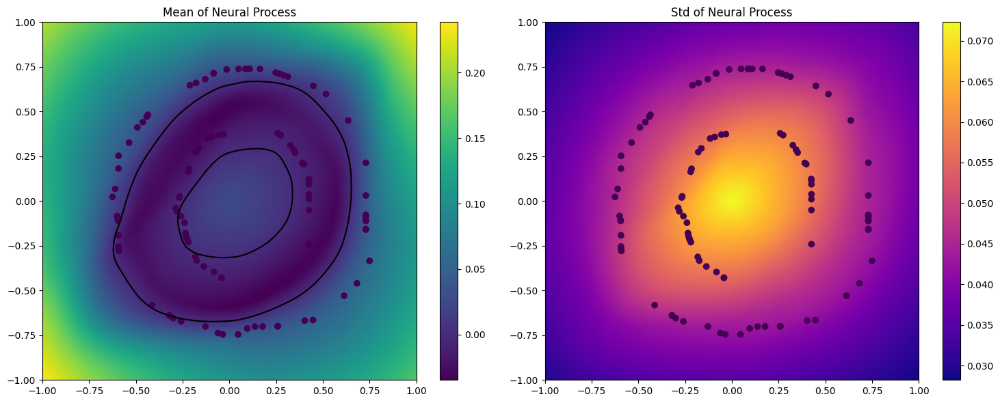

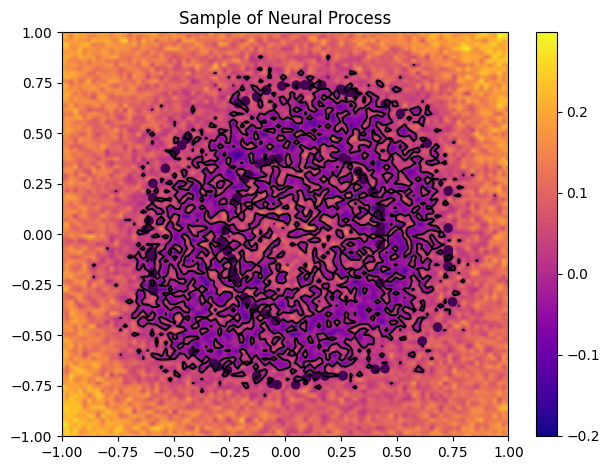

Epoch 7: 100%|███████████████████| 93/93 [00:36<00:00,  2.55batch/s, loss=-1.59]


Epoch: 7, Avg_loss: -1.5585481095057663


Epoch 8:   1%|▏                   | 1/93 [00:00<00:38,  2.40batch/s, loss=-1.56]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


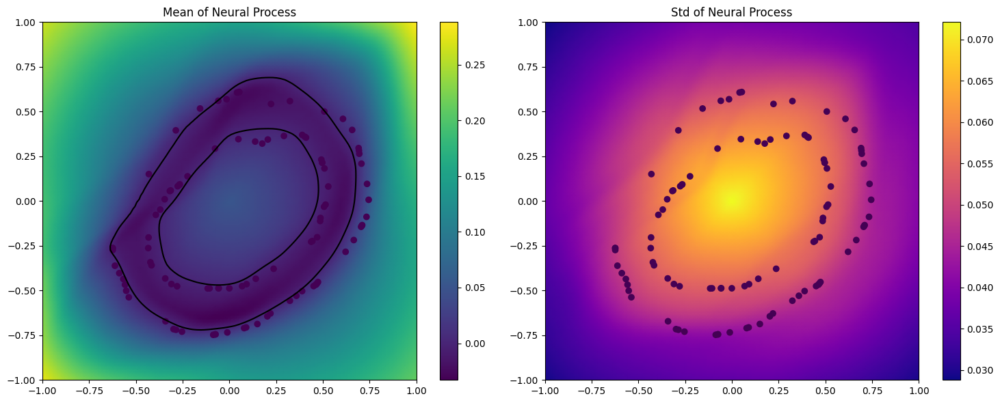

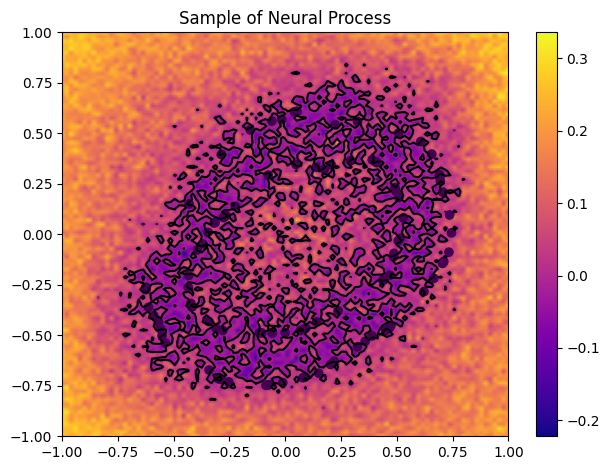

Epoch 8: 100%|███████████████████| 93/93 [00:36<00:00,  2.55batch/s, loss=-1.57]


Epoch: 8, Avg_loss: -1.574413949443448


Epoch 9:   1%|▏                   | 1/93 [00:00<00:38,  2.41batch/s, loss=-1.59]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


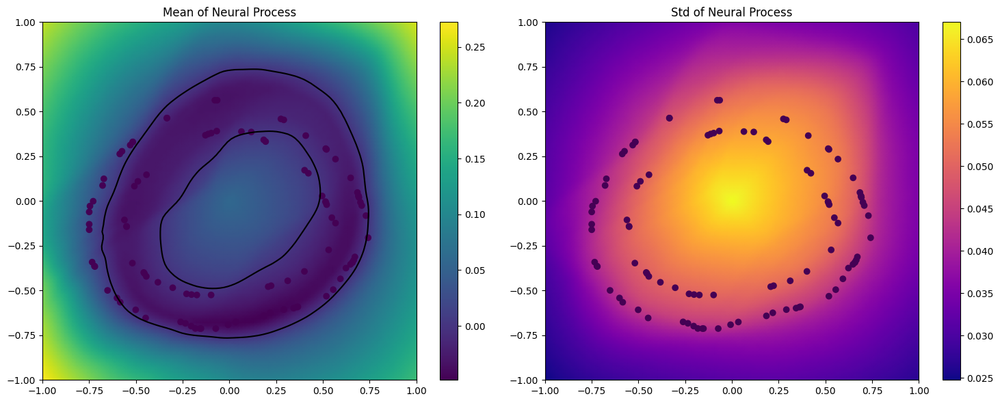

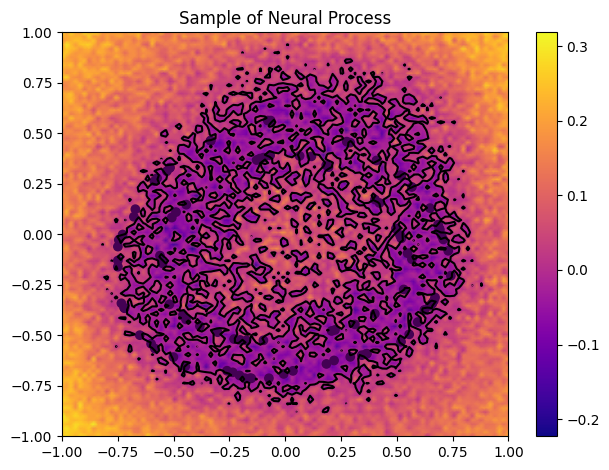

Epoch 9: 100%|███████████████████| 93/93 [00:36<00:00,  2.56batch/s, loss=-1.63]


Epoch: 9, Avg_loss: -1.5923073137960126


Epoch 10:   1%|▏                  | 1/93 [00:00<00:38,  2.39batch/s, loss=-1.59]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


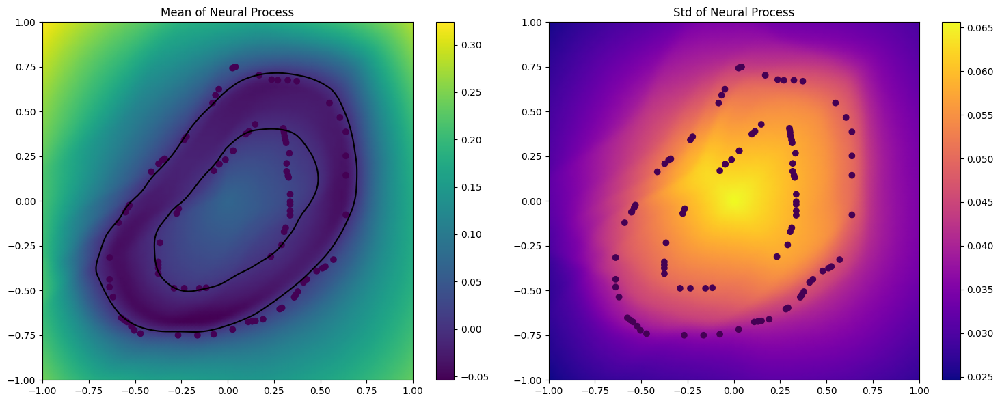

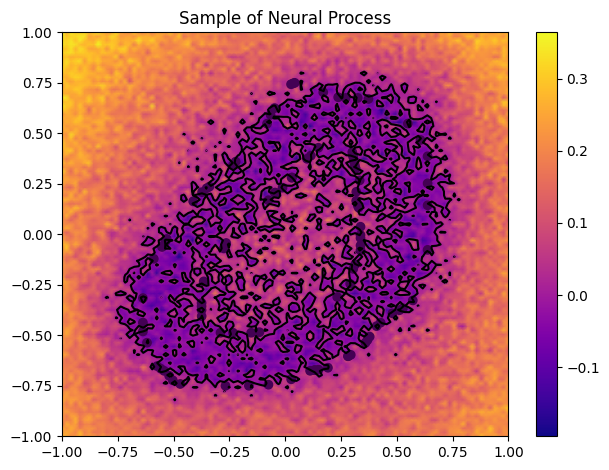

Epoch 10: 100%|██████████████████| 93/93 [00:36<00:00,  2.52batch/s, loss=-1.65]


Epoch: 10, Avg_loss: -1.6147492419007003


Epoch 11:   1%|▏                  | 1/93 [00:00<00:38,  2.41batch/s, loss=-1.66]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


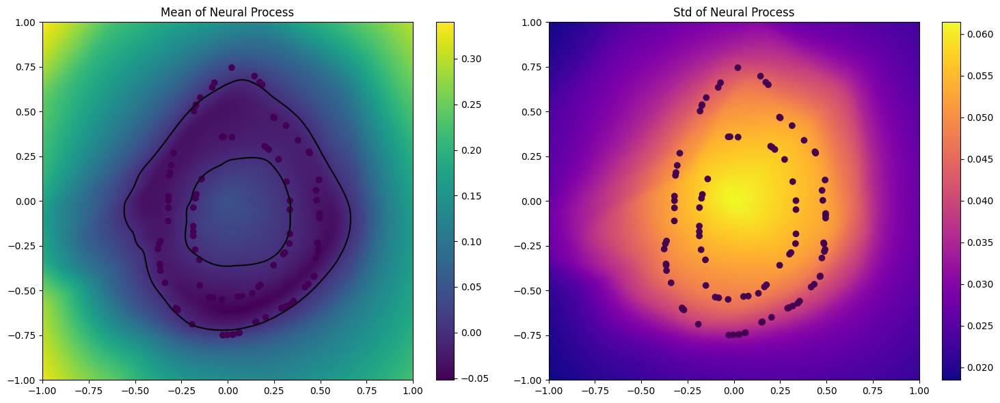

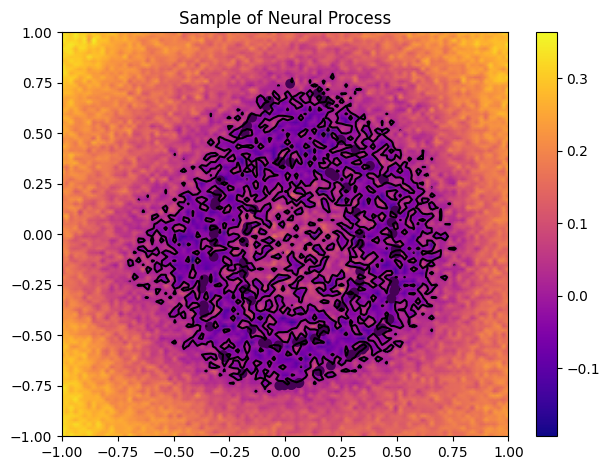

Epoch 11: 100%|██████████████████| 93/93 [00:36<00:00,  2.53batch/s, loss=-1.64]


Epoch: 11, Avg_loss: -1.629233541027192


Epoch 12:   1%|▏                  | 1/93 [00:00<00:38,  2.38batch/s, loss=-1.65]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


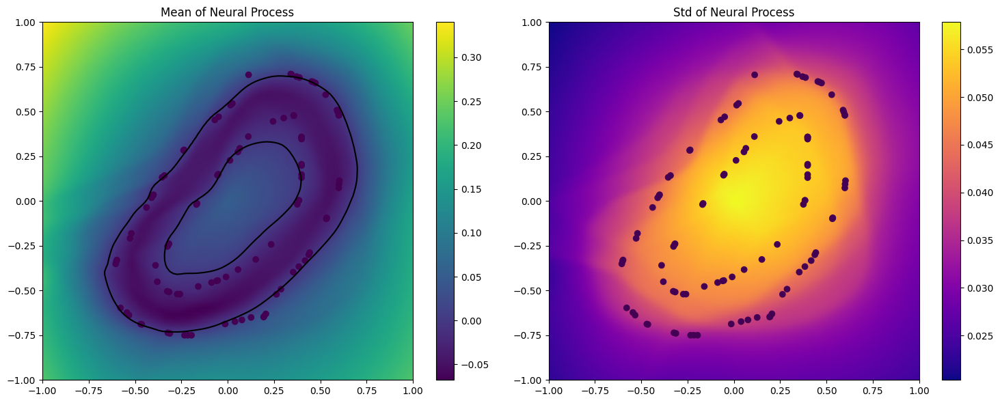

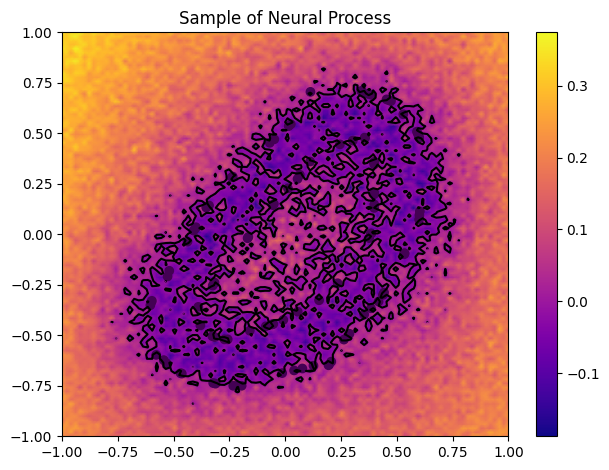

Epoch 12: 100%|██████████████████| 93/93 [00:34<00:00,  2.66batch/s, loss=-1.63]


Epoch: 12, Avg_loss: -1.657441827558702


Epoch 13:   1%|▏                  | 1/93 [00:00<00:36,  2.54batch/s, loss=-1.68]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


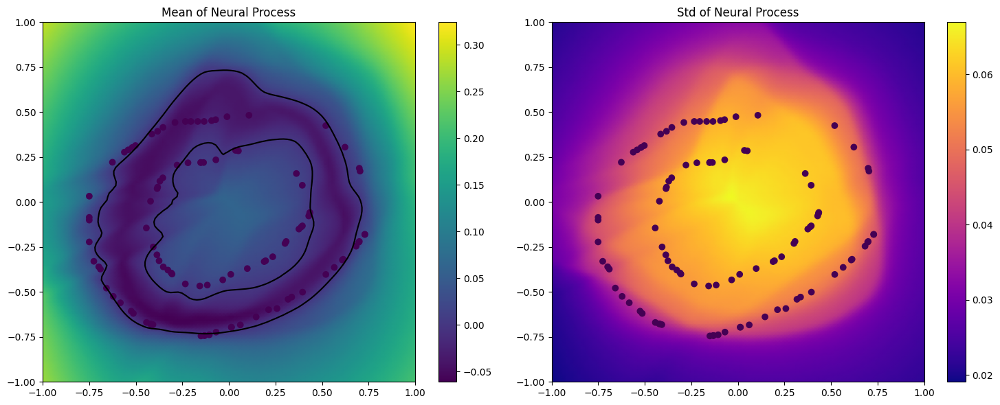

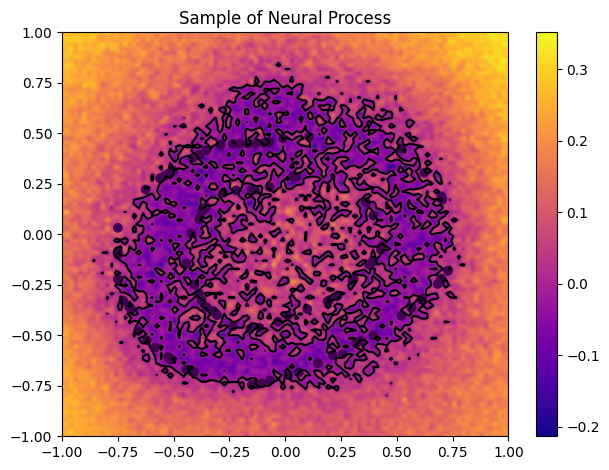

Epoch 13: 100%|██████████████████| 93/93 [00:36<00:00,  2.56batch/s, loss=-1.68]


Epoch: 13, Avg_loss: -1.6793234194478681


Epoch 14:   1%|▏                   | 1/93 [00:00<00:37,  2.46batch/s, loss=-1.7]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


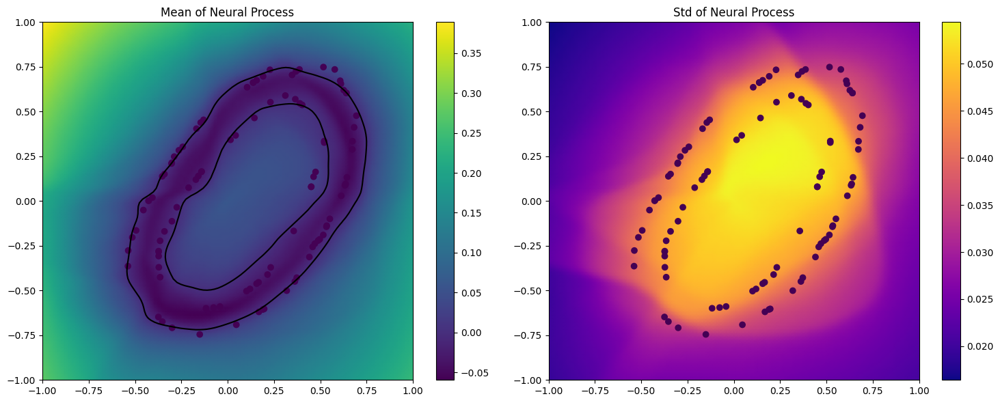

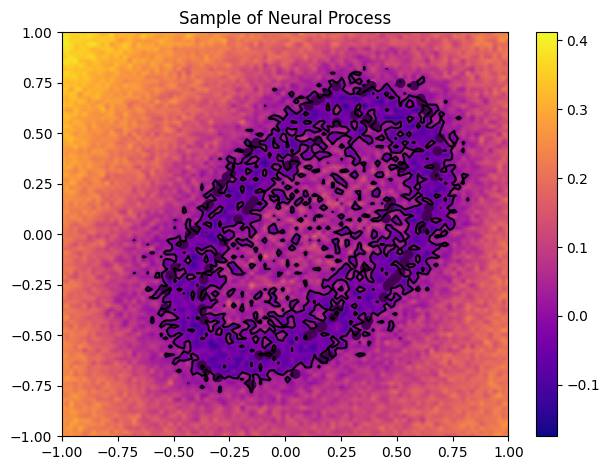

Epoch 14: 100%|██████████████████| 93/93 [00:36<00:00,  2.54batch/s, loss=-1.67]


Epoch: 14, Avg_loss: -1.7380554265873407


Epoch 15:   1%|▏                  | 1/93 [00:00<00:38,  2.39batch/s, loss=-1.65]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


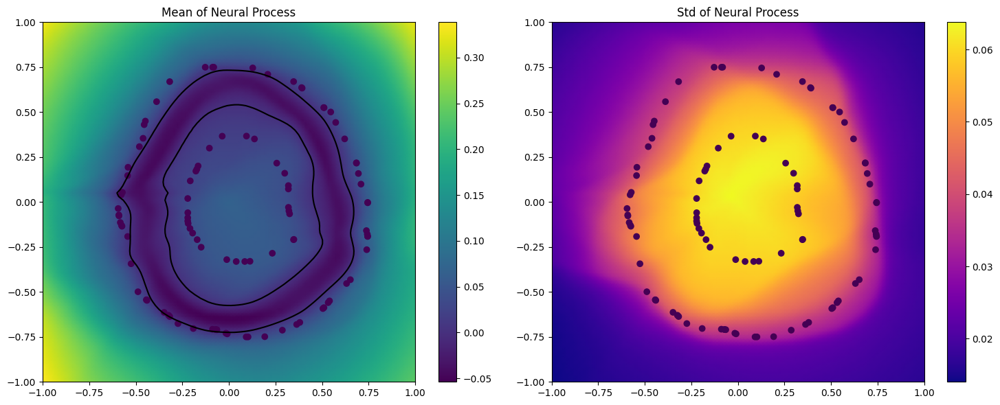

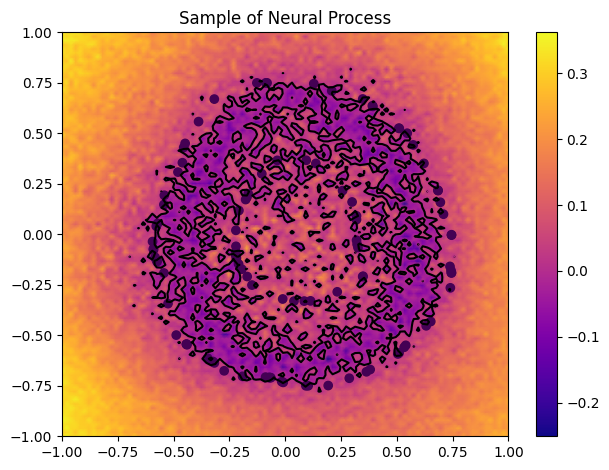

Epoch 15: 100%|██████████████████| 93/93 [00:38<00:00,  2.43batch/s, loss=-1.79]


Epoch: 15, Avg_loss: -1.7553407299903132


Epoch 16:   1%|▏                  | 1/93 [00:00<00:37,  2.44batch/s, loss=-1.78]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


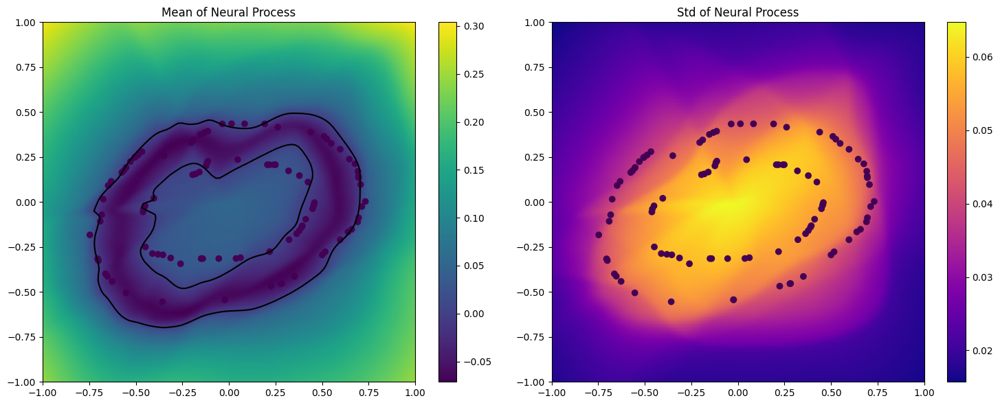

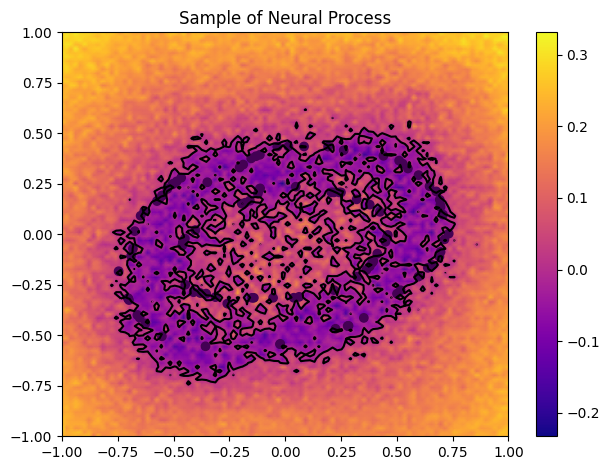

Epoch 16: 100%|███████████████████| 93/93 [00:37<00:00,  2.51batch/s, loss=-1.9]


Epoch: 16, Avg_loss: -1.806354586796094


Epoch 17:   1%|▏                  | 1/93 [00:00<00:38,  2.39batch/s, loss=-1.86]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


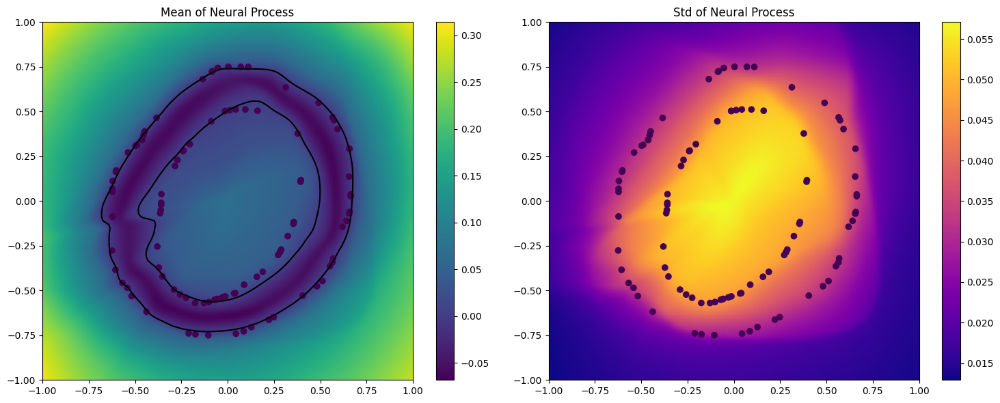

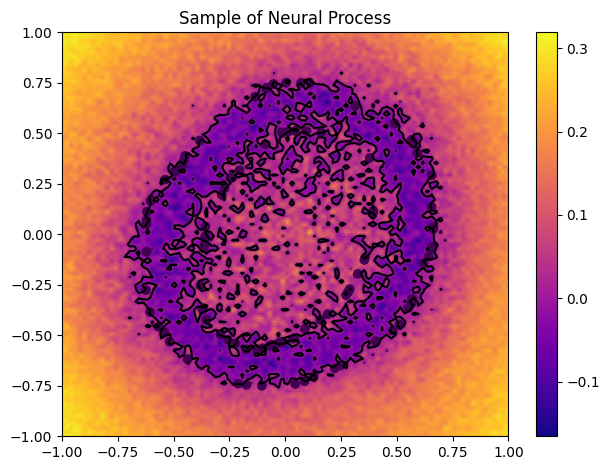

Epoch 17: 100%|██████████████████| 93/93 [00:36<00:00,  2.54batch/s, loss=-1.96]


Epoch: 17, Avg_loss: -1.8898186350381503


Epoch 18:   1%|▏                  | 1/93 [00:00<00:39,  2.33batch/s, loss=-1.87]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


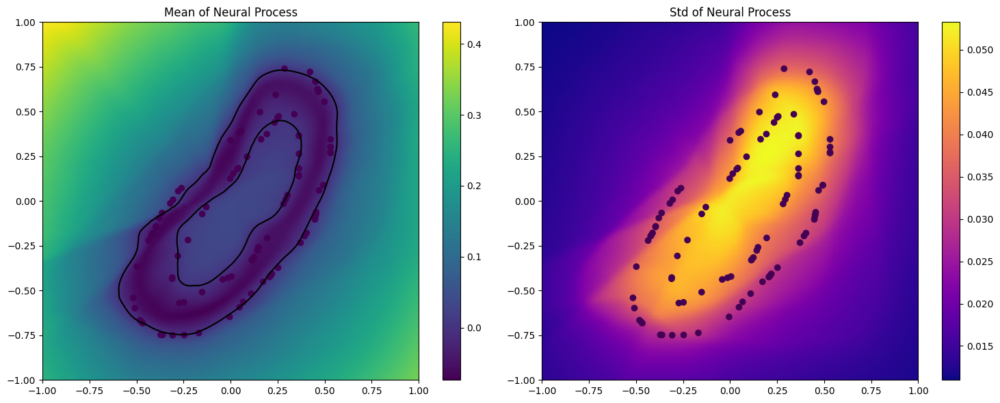

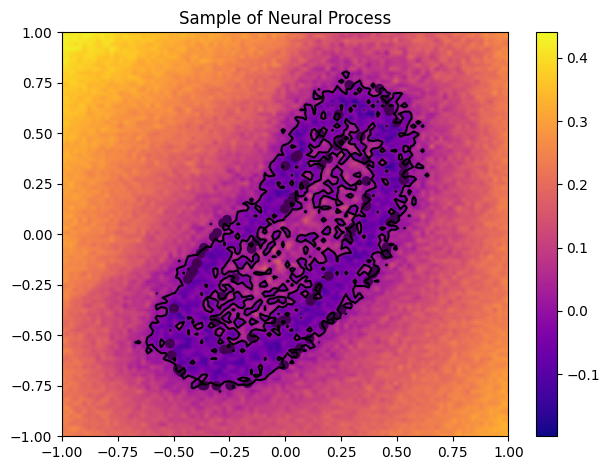

Epoch 18: 100%|██████████████████| 93/93 [00:38<00:00,  2.41batch/s, loss=-1.98]


Epoch: 18, Avg_loss: -1.9088453144155524


Epoch 19:   1%|▏                  | 1/93 [00:00<00:39,  2.36batch/s, loss=-1.94]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


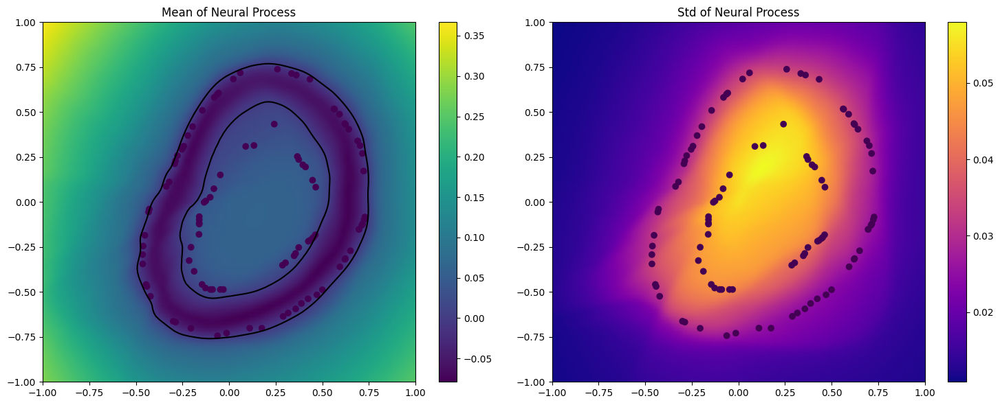

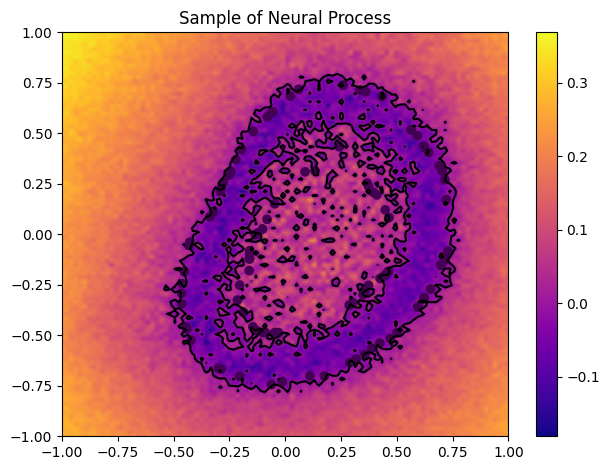

Epoch 19: 100%|██████████████████| 93/93 [00:37<00:00,  2.50batch/s, loss=-1.98]


Epoch: 19, Avg_loss: -1.9477767264971169


Epoch 20:   1%|▏                  | 1/93 [00:00<00:39,  2.34batch/s, loss=-1.68]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


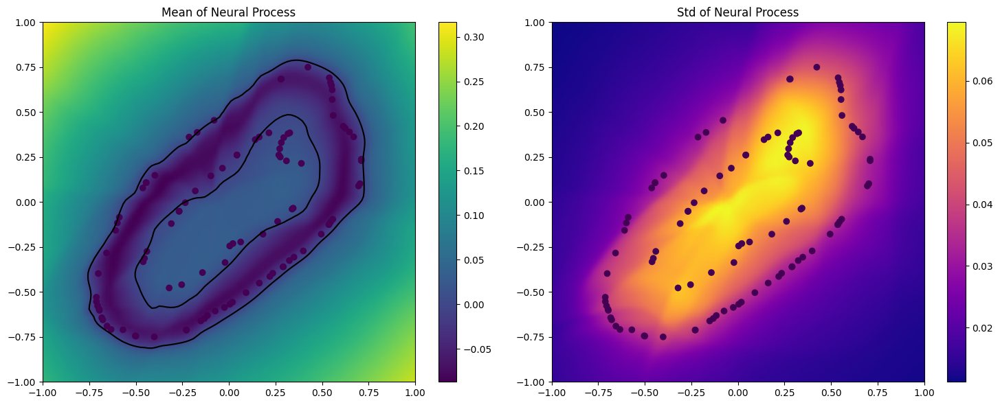

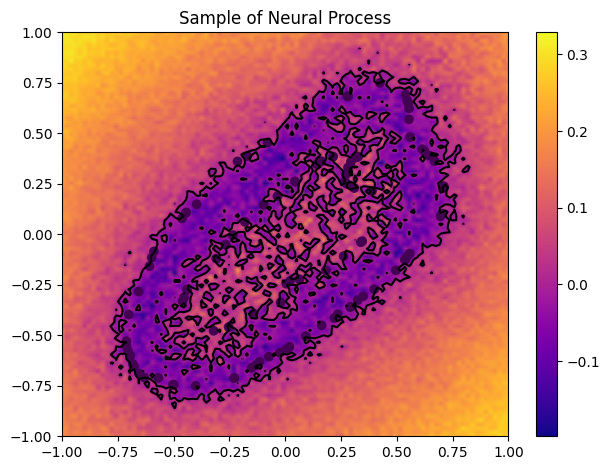

Epoch 20: 100%|██████████████████| 93/93 [00:37<00:00,  2.46batch/s, loss=-1.99]


Epoch: 20, Avg_loss: -1.9491919266280306


Epoch 21:   1%|▏                  | 1/93 [00:00<00:42,  2.14batch/s, loss=-1.94]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


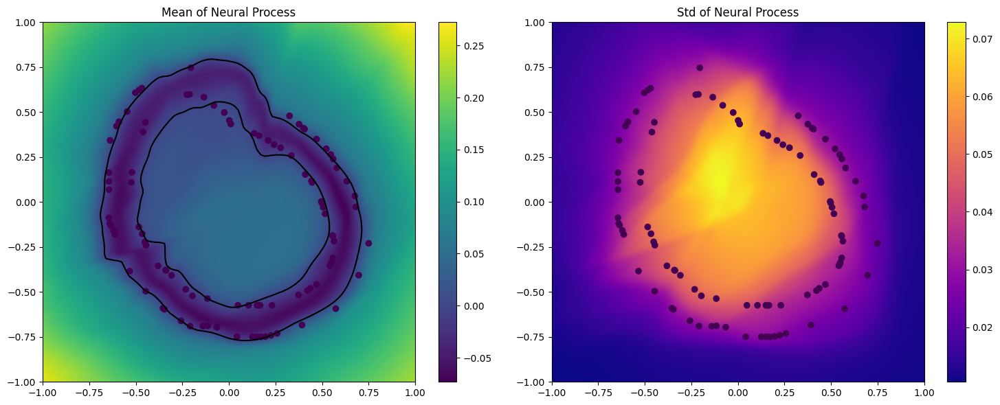

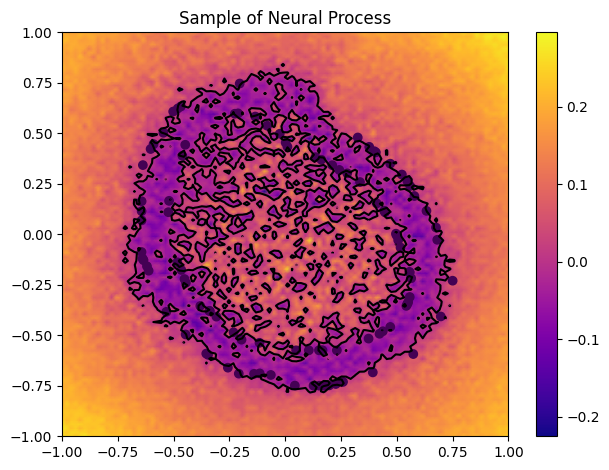

Epoch 21: 100%|██████████████████| 93/93 [00:37<00:00,  2.47batch/s, loss=-2.03]


Epoch: 21, Avg_loss: -1.9727252337240404


Epoch 22:   1%|▏                  | 1/93 [00:00<00:39,  2.36batch/s, loss=-2.02]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


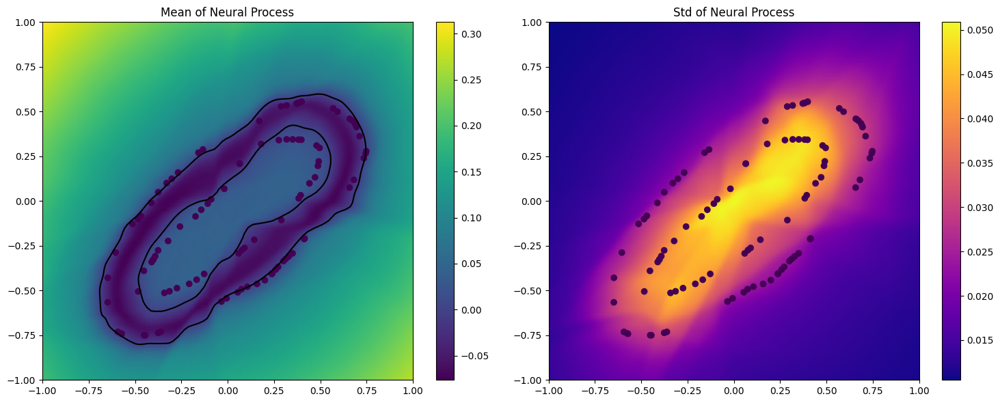

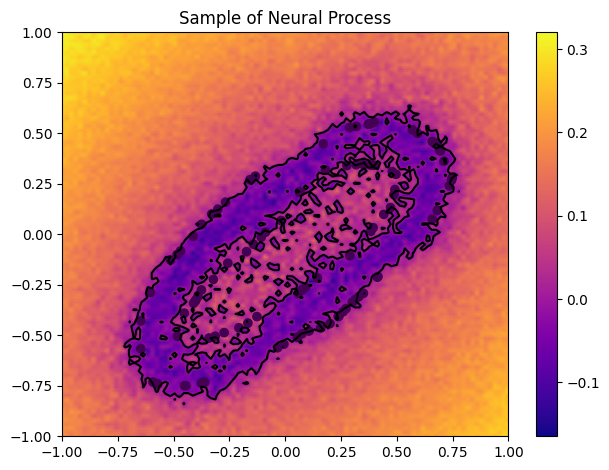

Epoch 22: 100%|██████████████████| 93/93 [00:37<00:00,  2.49batch/s, loss=-2.05]


Epoch: 22, Avg_loss: -2.0075266027963288


Epoch 23:   1%|▏                  | 1/93 [00:00<00:41,  2.19batch/s, loss=-1.99]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


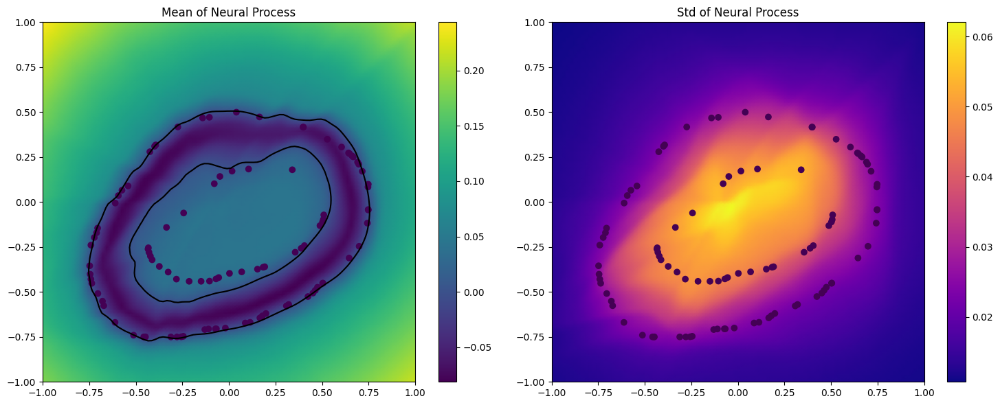

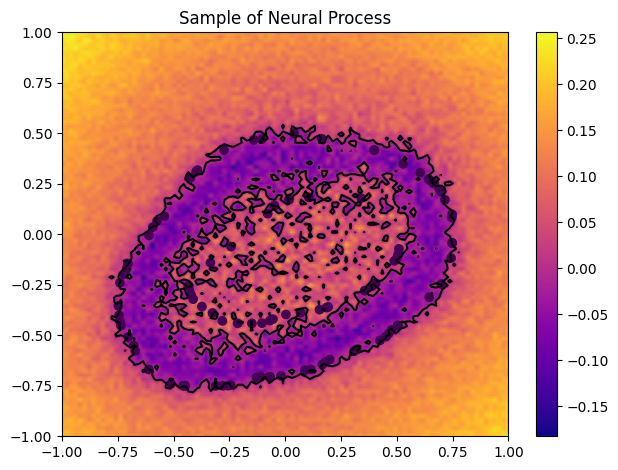

Epoch 23: 100%|██████████████████| 93/93 [00:38<00:00,  2.43batch/s, loss=-1.94]


Epoch: 23, Avg_loss: -2.025179615584753


Epoch 24:   1%|▏                     | 1/93 [00:00<00:41,  2.20batch/s, loss=-2]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


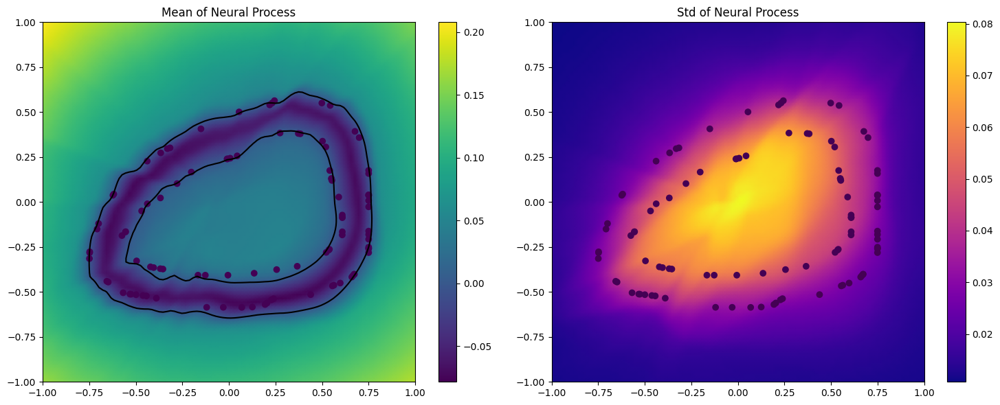

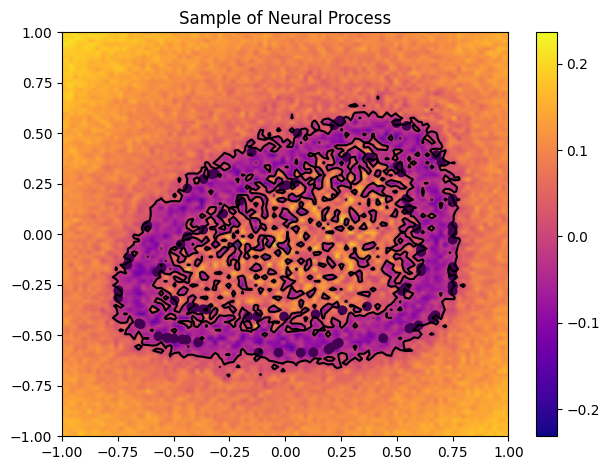

Epoch 24: 100%|██████████████████| 93/93 [00:37<00:00,  2.51batch/s, loss=-2.06]


Epoch: 24, Avg_loss: -2.023633855645375


Epoch 25:   1%|▏                  | 1/93 [00:00<00:38,  2.37batch/s, loss=-2.02]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


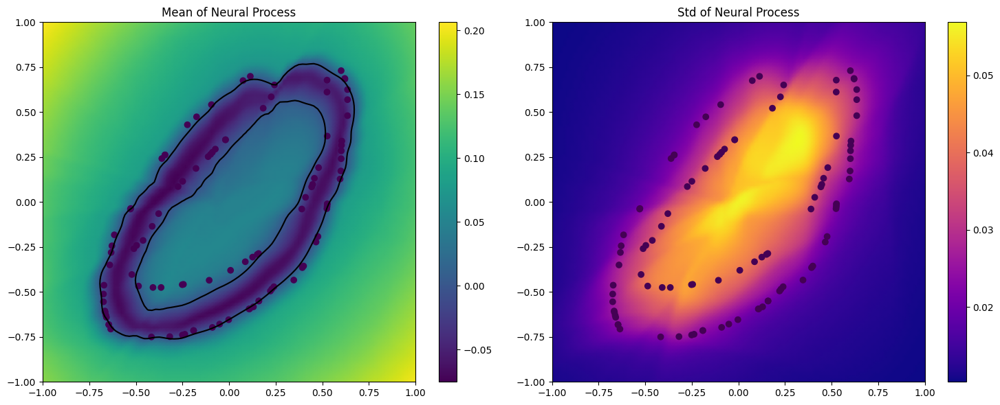

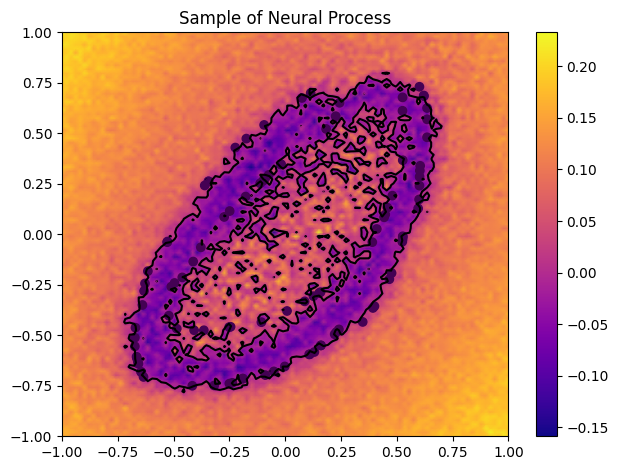

Epoch 25: 100%|██████████████████| 93/93 [00:36<00:00,  2.52batch/s, loss=-2.07]


Epoch: 25, Avg_loss: -2.0343685150146484


Epoch 26:   1%|▏                  | 1/93 [00:00<00:39,  2.33batch/s, loss=-2.07]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


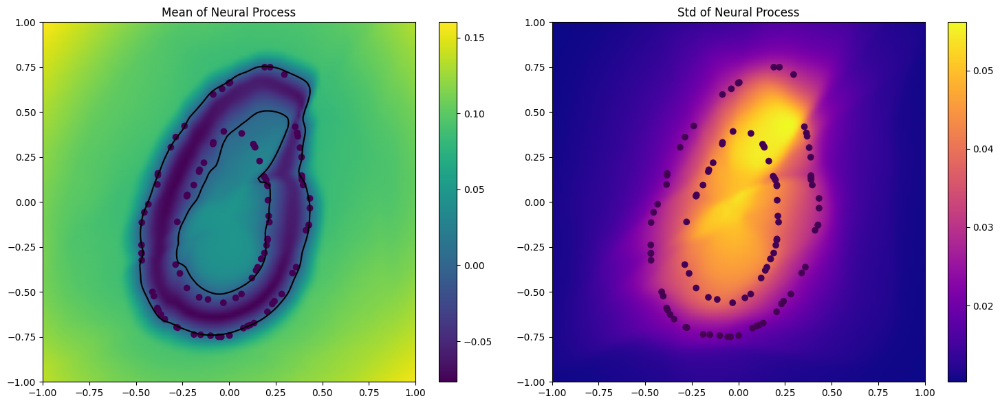

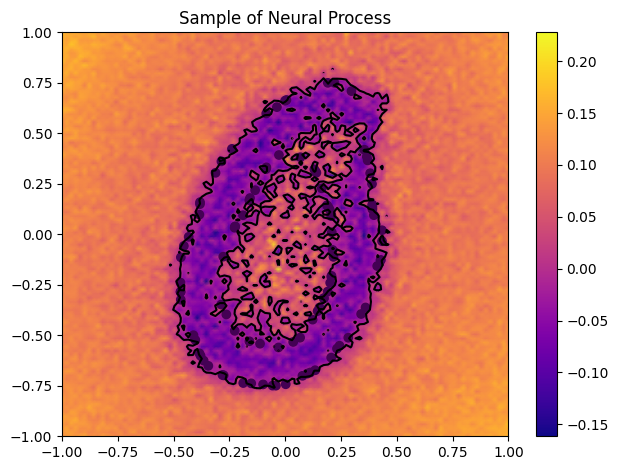

Epoch 26: 100%|██████████████████| 93/93 [00:36<00:00,  2.52batch/s, loss=-2.01]


Epoch: 26, Avg_loss: -2.0347130875433646


Epoch 27:   1%|▏                  | 1/93 [00:00<00:39,  2.32batch/s, loss=-2.06]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


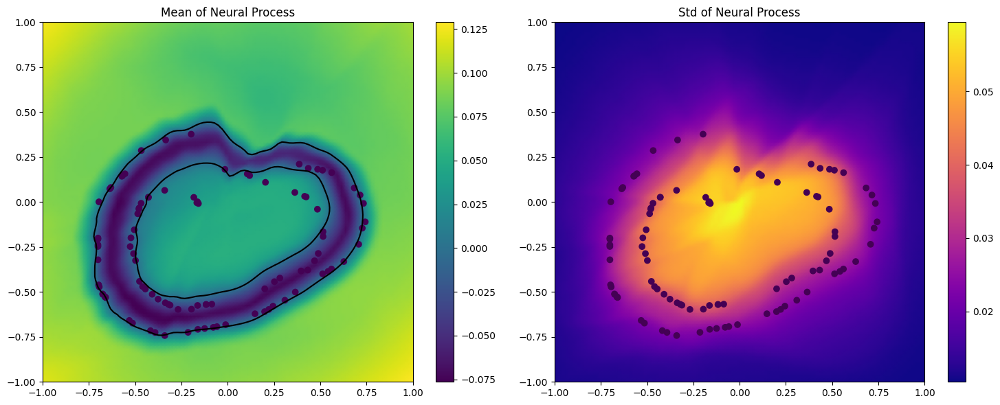

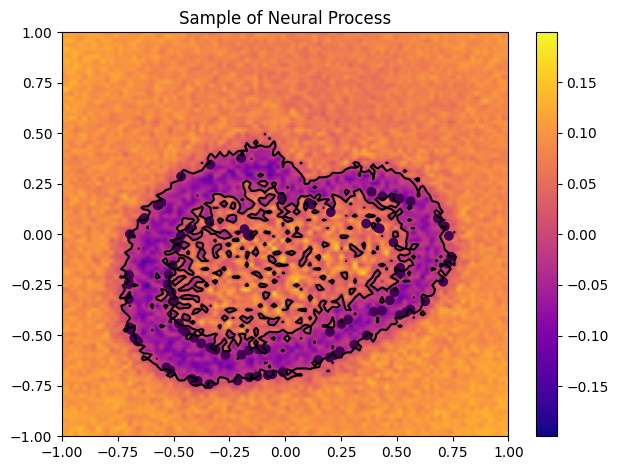

Epoch 27: 100%|██████████████████| 93/93 [00:39<00:00,  2.38batch/s, loss=-2.01]


Epoch: 27, Avg_loss: -2.0538102170472503


Epoch 28:   1%|▏                  | 1/93 [00:00<00:40,  2.27batch/s, loss=-2.01]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


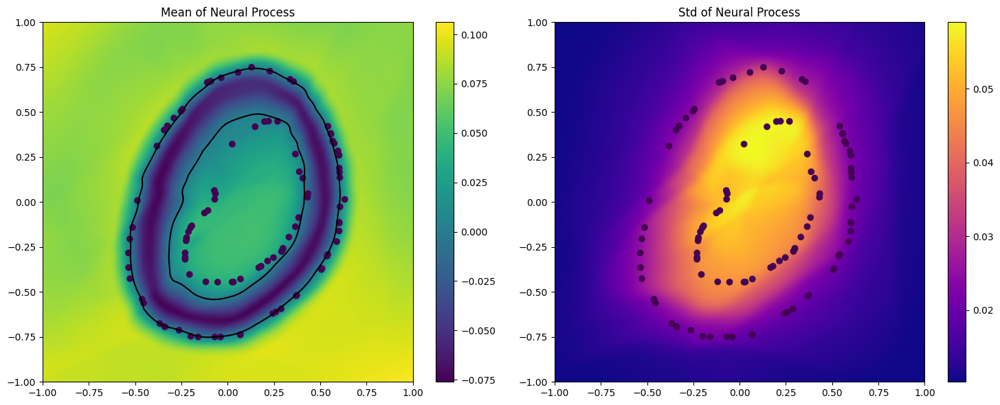

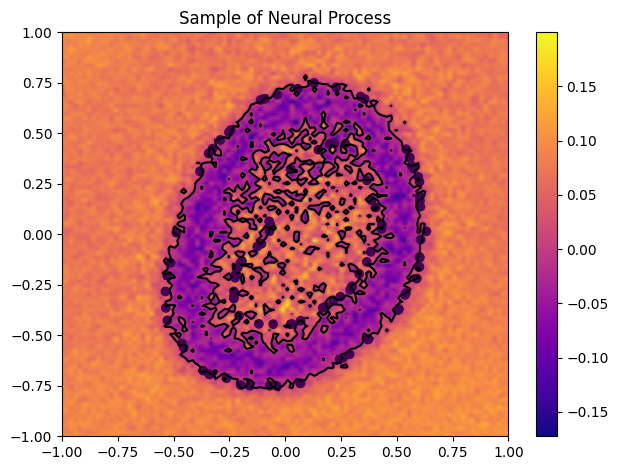

Epoch 28: 100%|██████████████████| 93/93 [00:37<00:00,  2.51batch/s, loss=-2.12]


Epoch: 28, Avg_loss: -2.0564085809133386


Epoch 29:   1%|▏                  | 1/93 [00:00<00:42,  2.16batch/s, loss=-2.05]

Original Label:  tensor(0)
torch.Size([1, 100, 2])


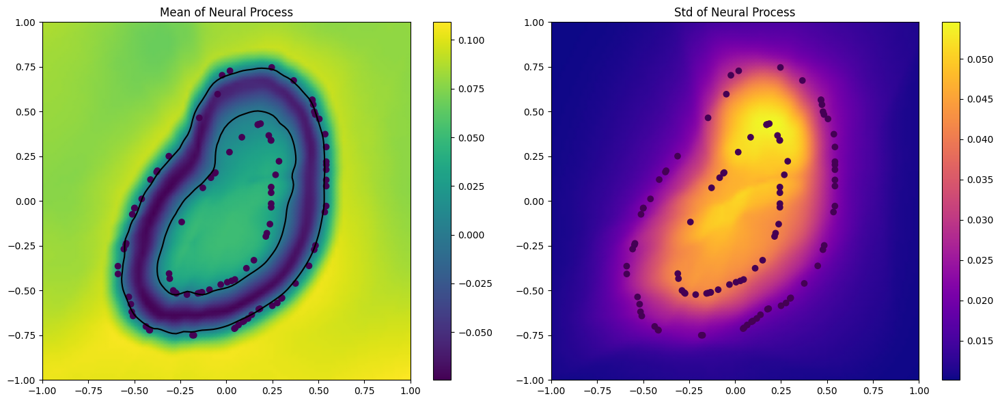

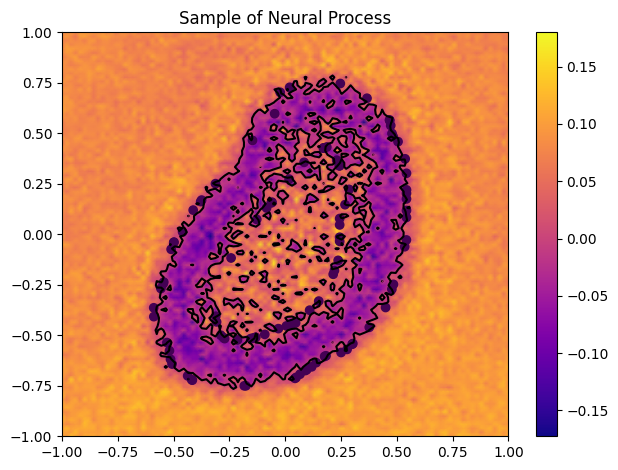

Epoch 29: 100%|██████████████████| 93/93 [00:37<00:00,  2.46batch/s, loss=-2.07]

Epoch: 29, Avg_loss: -2.058590672349417


In [18]:
train(model, optim, train_dataloader,test_dataloader, epochs, n_context, n_target)

Original Label:  tensor(0)
torch.Size([1, 100, 2])


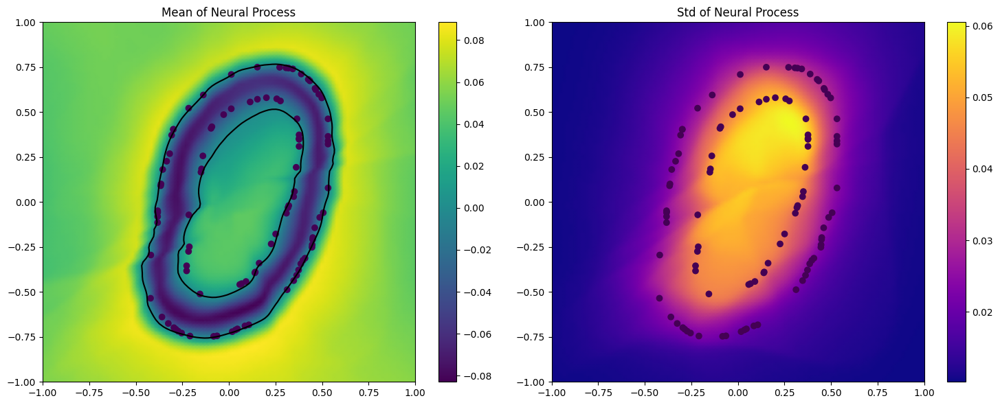

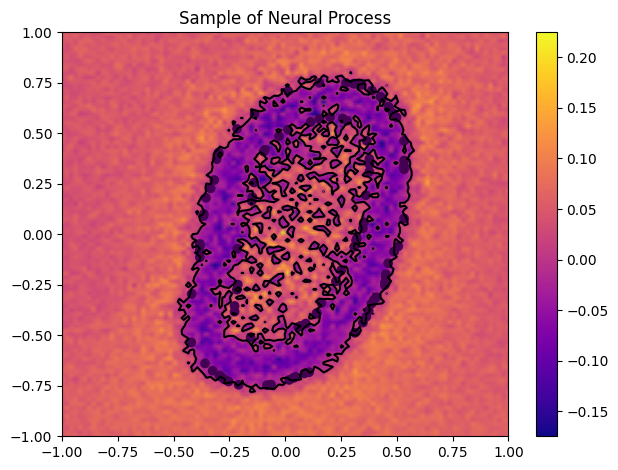

In [19]:
y_pred, kl, loss, y_std = test(model,test_dataloader, plot=True, size=100)

Original Label:  tensor(0)
N context points:  100
torch.Size([1, 100, 2])


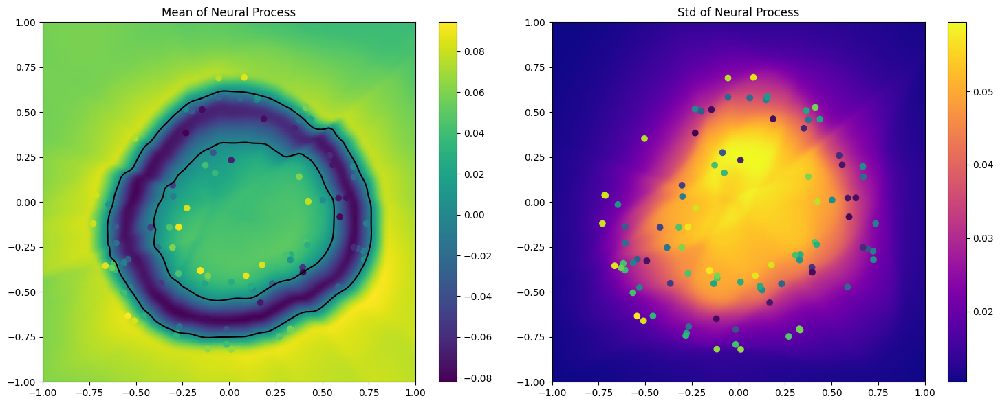

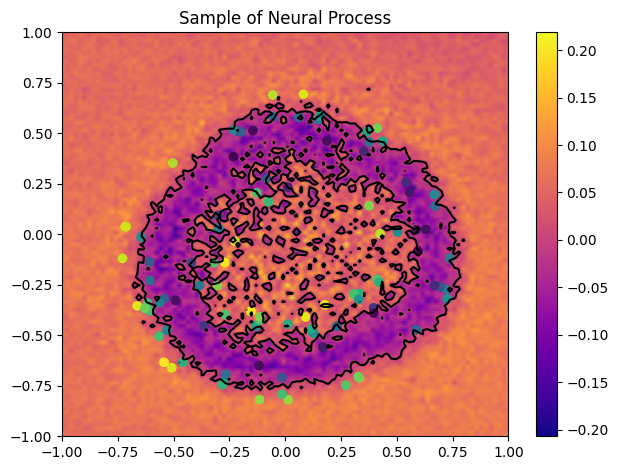

Original Label:  tensor(0)
N context points:  200
torch.Size([1, 200, 2])


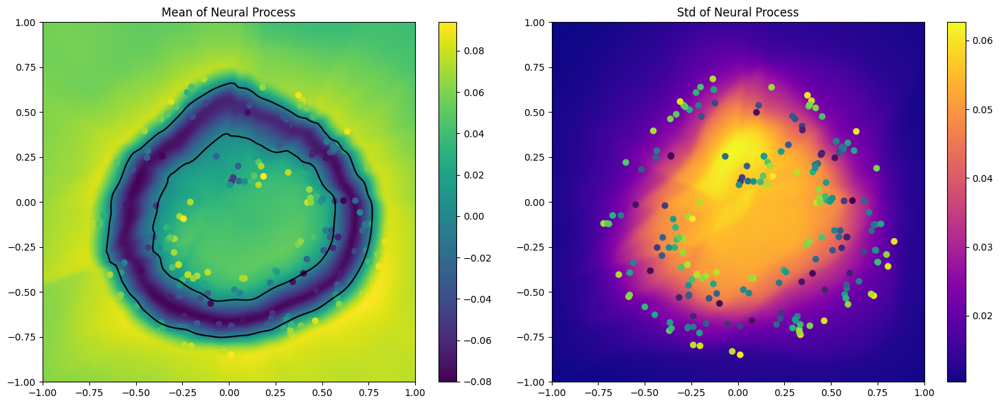

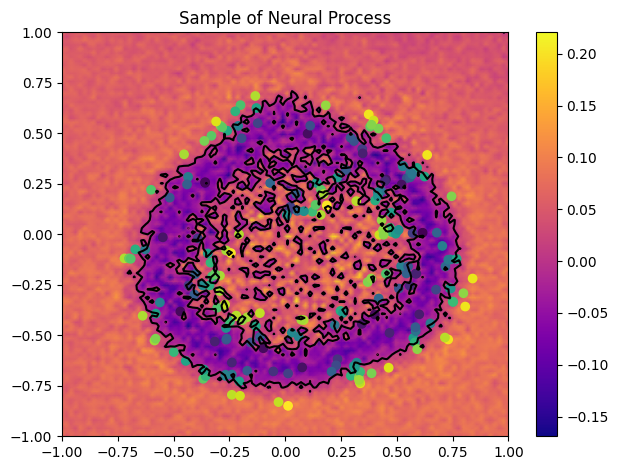

Original Label:  tensor(0)
N context points:  300
torch.Size([1, 300, 2])


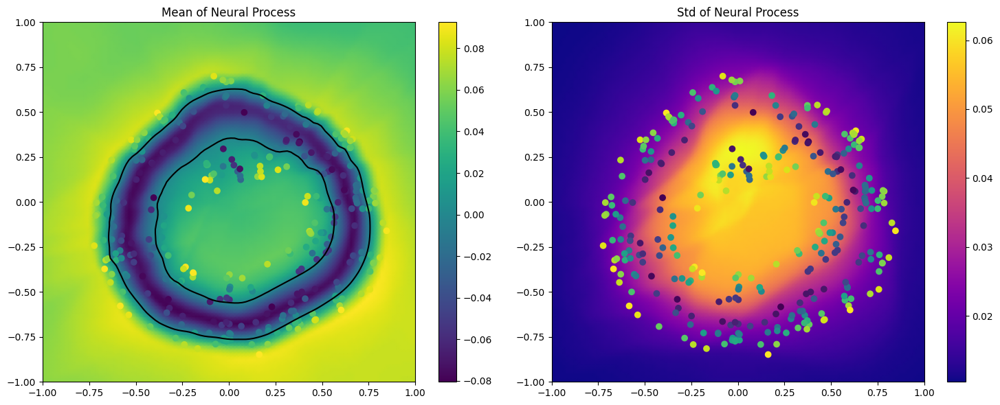

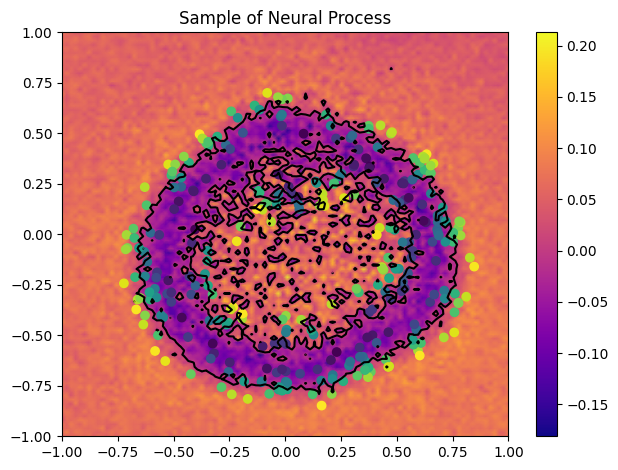

In [20]:
test_progress(model,test_dataloader, plot=True, sizes=[100,200,300])